<a href="https://colab.research.google.com/github/da-head0/cctv-anomaly-detection/blob/main/1_yolov5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [11]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -U -r yolov5/requirements.txt  # install dependencies

Cloning into 'yolov5'...
remote: Enumerating objects: 6179, done.
remote: Counting objects: 100% (199/199), done.
remote: Compressing objects: 100% (114/114), done.
remote: Total 6179 (delta 122), reused 141 (delta 85), pack-reused 5980
Receiving objects: 100% (6179/6179), 8.73 MiB | 22.08 MiB/s, done.
Resolving deltas: 100% (4216/4216), done.
     |████████████████████████████████| 10.3MB 5.6MB/s 
     |████████████████████████████████| 15.3MB 377kB/s 
     |████████████████████████████████| 50.4MB 113kB/s 
     |████████████████████████████████| 3.0MB 65.1MB/s 
     |████████████████████████████████| 645kB 72.9MB/s 
     |████████████████████████████████| 27.4MB 1.3MB/s 
Requirement already up-to-date: torch>=1.7.0 in /usr/local/lib/python3.7/dist-packages (from -r yolov5/requirements.txt (line 10)) (1.8.1+cu101)
Requirement already up-to-date: torchvision>=0.8.1 in /usr/local/lib/python3.7/dist-packages (from -r yolov5/requirements.txt (line 11)) (0.9.1+cu101)
     |████████████████

In [1]:
%cd yolov5

/content/yolov5


In [2]:
!git reset --hard 886f1c03d839575afecb059accf74296fad395b6

HEAD is now at 886f1c0 DDP after autoanchor reorder (#2421)


In [6]:
#!pip install utils

In [3]:
# install dependencies as necessary
import torch
#import utils

from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', major=6, minor=0, total_memory=16280MB, multi_processor_count=56)


### 아쿠아리움 데이터셋 (사진)

In [ ]:
# Export code snippet and paste here
%cd /content

# Aquarium dataset
!curl -L "https://app.roboflow.com/ds/JhRrsiPwm9?key=KhqPgb9SZP" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1321      0 --:--:-- --:--:-- --:--:--  1321
100 66.9M  100 66.9M    0     0  60.5M      0  0:00:01  0:00:01 --:--:--  211M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/IMG_2289_jpeg_jpg.rf.fe2a7a149e7b11f2313f5a7b30386e85.jpg  
 extracting: test/images/IMG_2301_jpeg_jpg.rf.2c19ae5efbd1f8611b5578125f001695.jpg  
 extracting: test/images/IMG_2319_jpeg_jpg.rf.6e20bf97d17b74a8948aa48776c40454.jpg  
 extracting: test/images/IMG_2347_jpeg_jpg.rf.7c71ac4b9301eb358cd4a832844dedcb.jpg  
 extracting: test/images/IMG_2354_jpeg_jpg.rf.396e872c7fb0a95e911806986995ee7a.jpg  
 extracting: test/images/IMG_2371_jpeg_jpg.rf.54505f60b6706da151c164

In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 7
names: ['fish', 'jellyfish', 'penguin', 'puffin', 'shark', 'starfish', 'stingray']

# Define Model Configuration and Architecture

We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

You do not need to edit these cells, but you may.

In [6]:
% cd ..
!git clone https://github.com/paulxiong/convert2Yolo.git 

/content
Cloning into 'convert2Yolo'...
remote: Enumerating objects: 221, done.
remote: Counting objects: 100% (20/20), done.
remote: Compressing objects: 100% (13/13), done.
remote: Total 221 (delta 5), reused 16 (delta 5), pack-reused 201
Receiving objects: 100% (221/221), 1004.76 KiB | 3.30 MiB/s, done.
Resolving deltas: 100% (90/90), done.


In [7]:
% cd convert2Yolo/

/content/convert2Yolo


In [14]:
data ="""punching
kicking
pushing
pulling
throwing
threaten
piercing
falldown
totter
around
stop and go
climbwall
drop
carring
pick up
steal
hugging
touching
sitdown"""

- 이상행동 데이터 라벨

In [15]:
f = open("names.txt", 'w')
f.write(data)
f.close()

In [25]:
a_file = open("names.txt", "r")

list_of_lists = []
for line in a_file:
  line = line.rstrip('\n')
  list_of_lists.append(line)

a_file.close()

print(len(list_of_lists))

19


- yolov5 ymal 형식

In [ ]:
train: /content/drive/MyDrive/dataset/cctv
val: /content/drive/MyDrive/dataset/cctv/val

nc: 19
names: ['punching', 'kicking', 'pushing', 'pulling', 'throwing', 'threaten', 'piercing', 'falldown', 'totter', 'around', 'stop and go', 'climbwall', 'drop', 'carring', 'pick up', 'steal', 'hugging', 'touching', 'sitdown']

- 이 내용을 data 폴더에 cctv.yaml로 저장한다.

In [17]:
!python3 example.py --datasets NIA2019 --img_path /content/drive/MyDrive/dataset/cctv/img/  --label /content/drive/MyDrive/dataset/cctv/xml --convert_output_path /content/output --img_type ".jpg" --cls_list_file /content/convert2Yolo/names.txt

Unkwon Datasets


In [ ]:
%cd /content/yolov5/data

In [28]:
# define number of classes based on YAML
import yaml
with open("cctv.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [29]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [30]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [31]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [32]:
%cd ..

/content/yolov5


# Train Custom YOLOv5 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [34]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 10 --data '/content/yolov5/data/cctv.yaml' --cfg ./models/custom_yolov5s.yaml --weights 'yolov5s.pt' --name yolov5s_results  --cache

/content/yolov5
github: ⚠️ WARNING: code is out of date by 137 commits. Use 'git pull' to update or 'git clone https://github.com/ultralytics/yolov5' to download latest.
YOLOv5 v4.0-126-g886f1c0 torch 1.8.1+cu101 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='/content/yolov5/data/cctv.yaml', device='', entity=None, epochs=10, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], linear_lr=False, local_rank=-1, log_artifacts=False, log_imgs=16, multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5s_results2', single_cls=False, sync_bn=False, total_batch_size=16, weights='yolov5s.pt', workers=8, world_size=1)
wandb: Install Weights & Biases for YOLOv5 logging with 'pip install wandb' (recommended)
S

## 현안
- yolov5 파일을 train 시키기 위해서는 좌표가 필요한 듯 하다.
- 하지만 AI hub 데이타셋엔 시간은 있고 좌표는 없는데.... 
- 훈련된 모델을 참고해서 다시 해보자.

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 194), started 0:06:39 ago. (Use '!kill 194' to kill it.)

<IPython.core.display.Javascript object>

- Accuracy가 0.65로 그렇게 잘 예측하진 않네요. 데이터셋 수가 적어서인가...

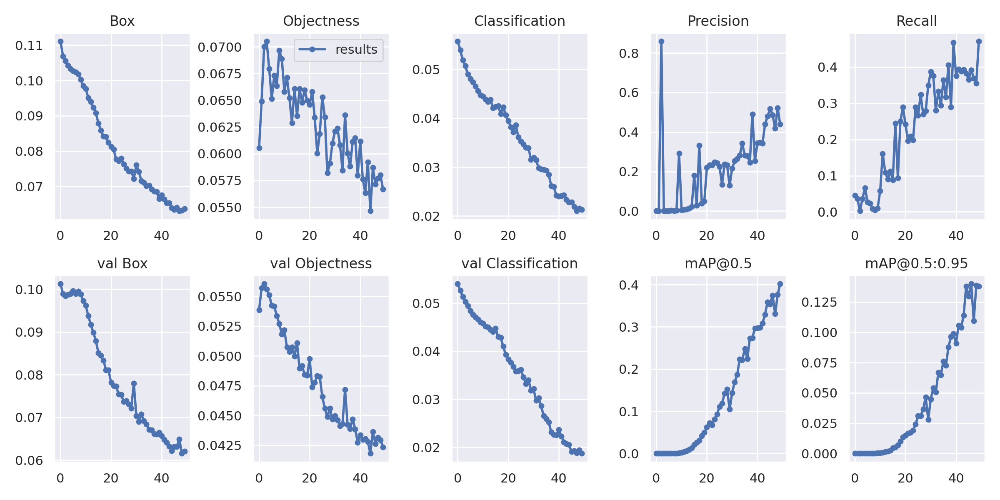

In [ ]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/yolov5s_results2/results.png', width=1000)  # view results.png

### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

- 이미지 어떻게 분류했는지 보기

GROUND TRUTH TRAINING DATA:


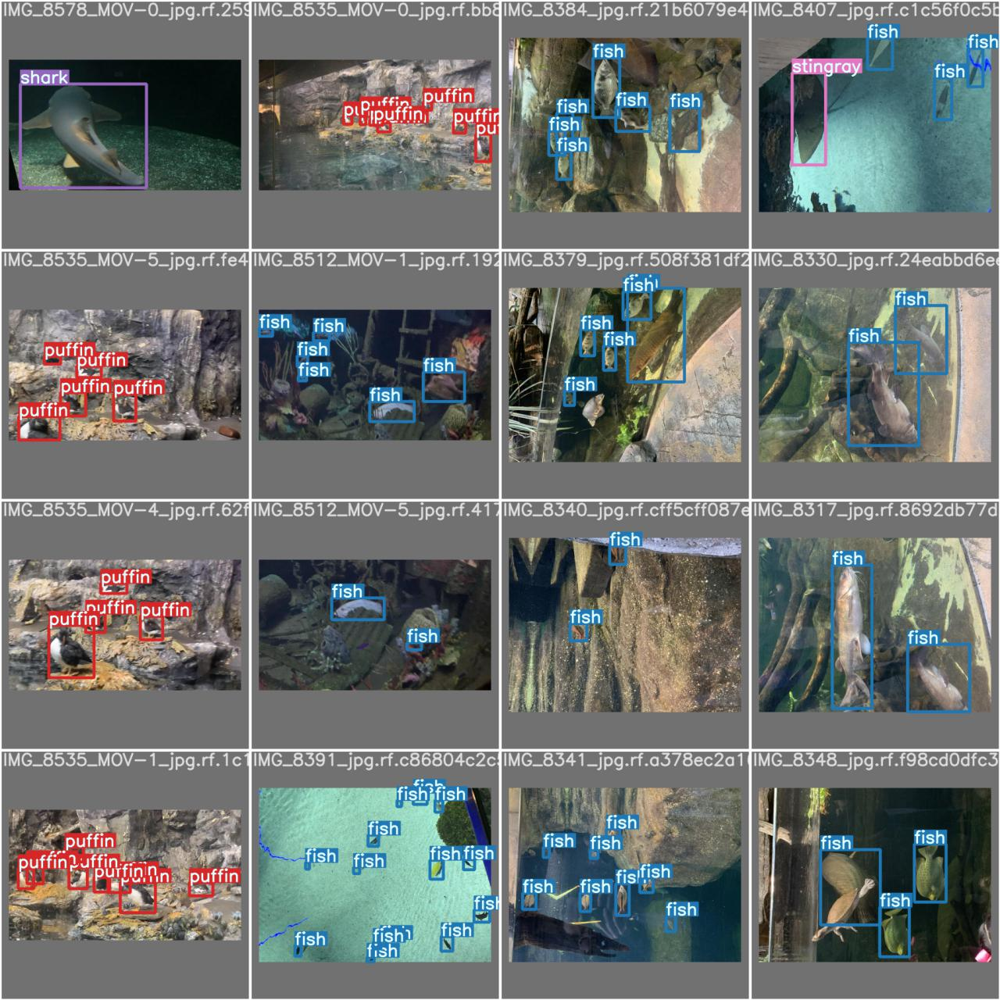

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results2/test_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


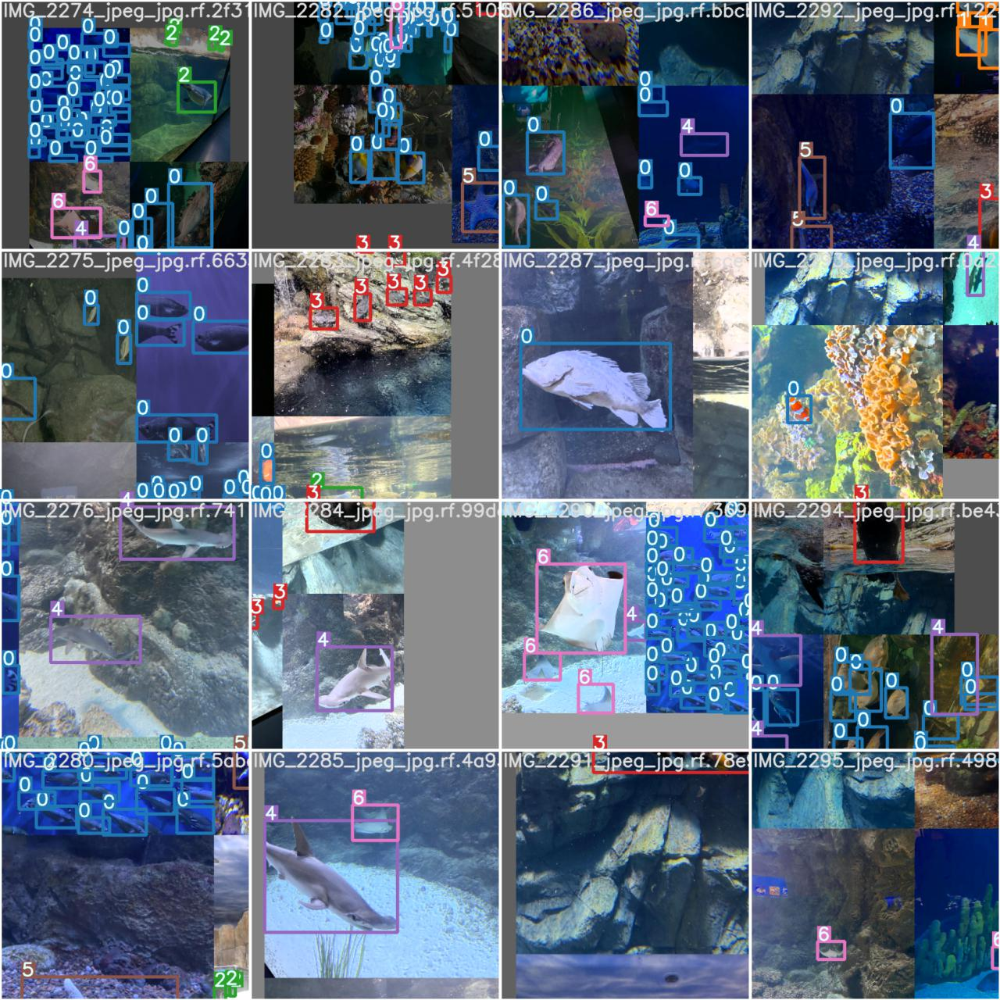

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results2/train_batch0.jpg', width=900)

## 직접 사진 넣어서 잘 예측하나 보기

In [ ]:
from IPython.display import Image
import os

val_img_path = '/content/yolov5/val1.jpg'

!python detect.py --weights /content/yolov5/runs/train/yolov5s_results4/weights/best.pt --img 416 --conf 0.5 --source "{val_img_path}"

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.5, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='/content/yolov5/val1.jpg', update=False, view_img=False, weights=['/content/yolov5/runs/train/yolov5s_results2/weights/best.pt'])
YOLOv5 v4.0-126-g886f1c0 torch 1.8.1+cu101 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 232 layers, 7262700 parameters, 0 gradients, 16.8 GFLOPS
image 1/1 /content/yolov5/val1.jpg: 224x416 Done. (0.012s)
Results saved to runs/detect/exp2
Done. (0.042s)


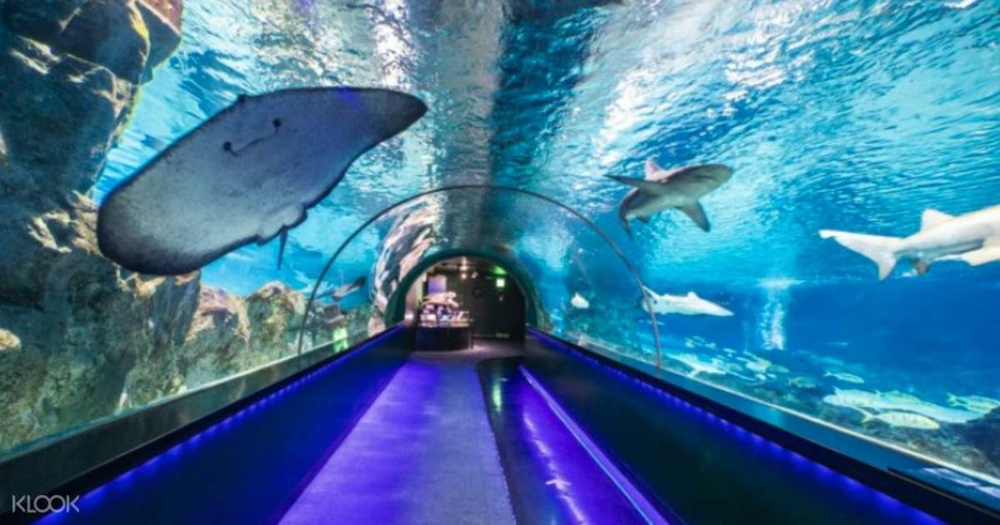

In [ ]:
Image('/content/yolov5/runs/detect/exp2/val1.jpg')

- 이렇게 예측했다. 우측은 상어인데..!


In [ ]:
from IPython.display import Image
import os

val_img_path = '/content/yolov5/val2.jpg'

!python detect.py --weights /content/yolov5/runs/train/yolov5s_results4/weights/best.pt --img 416 --conf 0.5 --source "{val_img_path}"

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.5, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='/content/yolov5/val2.jpg', update=False, view_img=False, weights=['/content/yolov5/runs/train/yolov5s_results2/weights/best.pt'])
YOLOv5 v4.0-126-g886f1c0 torch 1.8.1+cu101 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 232 layers, 7262700 parameters, 0 gradients, 16.8 GFLOPS
image 1/1 /content/yolov5/val2.jpg: 288x416 7 fishs, Done. (0.014s)
Results saved to runs/detect/exp3
Done. (0.052s)


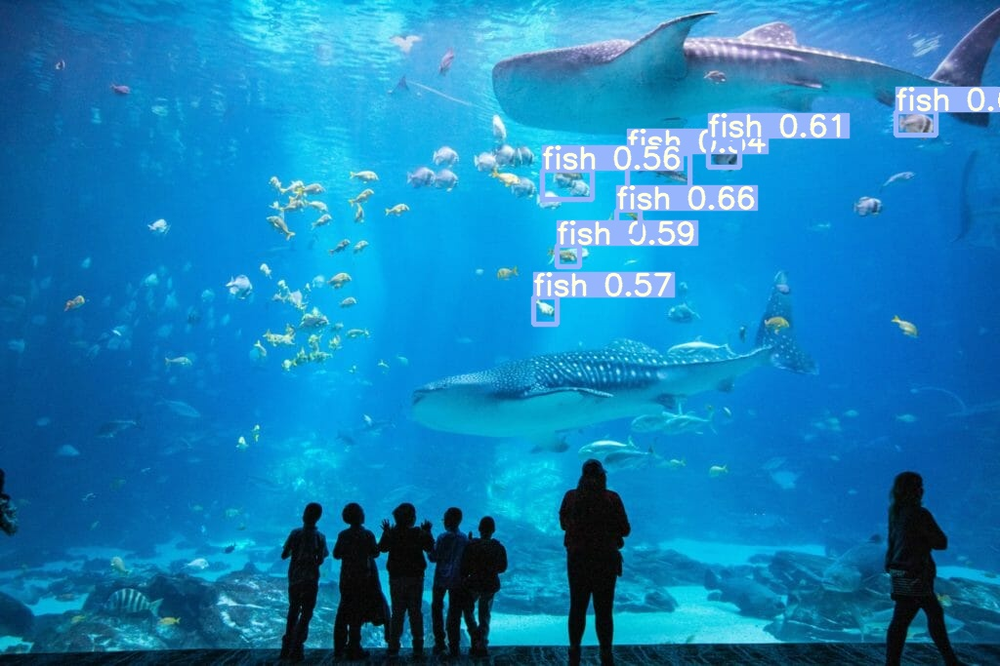

In [ ]:
Image('/content/yolov5/runs/detect/exp3/val2.jpg')

- 음... 크다란 건 예측을 못했다. train/test 분리가 필요해 보인다.

### 영상에서 아쿠아리움 친구들 인식하기

In [ ]:
import torch
from IPython.display import Image, clear_output  # to display images

clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', major=6, minor=0, total_memory=16280MB, multi_processor_count=56)


In [ ]:
#영상 파일 올리기
from google.colab import files 
uploaded = files.upload()

Saving Shark Dive Dubai Aquarium - Close Encounter.mp4 to Shark Dive Dubai Aquarium - Close Encounter.mp4


In [ ]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results4/weights/best.pt  --source /content/yolov5/sh.mp4

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.25, device='', exist_ok=False, img_size=640, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='/content/yolov5/sh.mp4', update=False, view_img=False, weights=['/content/yolov5/runs/train/yolov5s_results4/weights/best.pt'])
YOLOv5 v4.0-126-g886f1c0 torch 1.8.1+cu101 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 232 layers, 7262700 parameters, 0 gradients, 16.8 GFLOPS
video 1/1 (1/4578) /content/yolov5/sh.mp4: 384x640 9 fishs, 3 sharks, Done. (0.014s)
video 1/1 (2/4578) /content/yolov5/sh.mp4: 384x640 9 fishs, 3 sharks, Done. (0.012s)
video 1/1 (3/4578) /content/yolov5/sh.mp4: 384x640 10 fishs, 2 sharks, Done. (0.012s)
video 1/1 (4/4578) /content/yolov5/sh.mp4: 384x640 6 fishs, 4 sharks, Done. (0.012s)
video 1/1 (5/4578) /content/yolov5/sh.mp4: 384x640 10 fishs, 2 sharks, Done. (0.013s)
video 1/1 (6/4578) /content/yolov5/sh.mp4: 384x640 7 fishs,

- 결과물

In [ ]:
from IPython.display import HTML

HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/vzJRwsWnuXc" title="YouTube video player" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>')